In [1]:
# Michael Wasserstein
# Plot_VV_Plan_View.py
# 4/11/2024
# Script takes in WRF outputs and plots a cross section of vertical velocity
# As well as plan view plots at 700 hPa and 800 hPa

####### Usage #########
# Conda environment - py37
# python /uufs/chpc.utah.edu/common/home/u1371671/WRF/Plotting_Scripts/Plot_Mesonet_Bias.py -r 2 -p 2
# -r represents the run number you want to plot
# -p is the wrf path (wrf1 or wrf2)
# -t is the time of interest (YYYYmmddHH)

import os, sys
sys.path.append('/uufs/chpc.utah.edu/common/home/u1371671/')
#from map_script import *

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib import colors
from matplotlib import pyplot as plt
from matplotlib.cm import get_cmap
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import (NullFormatter, ScalarFormatter)
import matplotlib
from matplotlib.colors import from_levels_and_colors, ListedColormap, LinearSegmentedColormap
import cartopy
import cartopy.crs as ccrs
from cartopy.io.img_tiles import GoogleTiles
import cartopy.feature as cfeature
from cartopy import crs
from cartopy.feature import NaturalEarthFeature, COLORS
import pyart
import metpy.calc as mpcalc
from metpy.units import units
import math
from metpy.plots import USCOUNTIES


import numpy as np
from netCDF4 import Dataset
from wrf import (getvar, to_np, get_cartopy, latlon_coords, vertcross,
                 cartopy_xlim, cartopy_ylim, interpline, CoordPair,ALL_TIMES)
import wrf
import glob
import pandas as pd
import datetime

import urllib.request as req
import os.path
import json
import urllib
import cmath

from scipy.ndimage import gaussian_filter


# ######## User input arguments #############
# import argparse
# parser = argparse.ArgumentParser()

# parser.add_argument("-r", "--run", help="WRF run of interest")
# parser.add_argument("-p", "--path", help="Wrf path - where is data (1 or 2")


# args = parser.parse_args()


###########################
##### stuff for WRF  ######
###########################
# Get user inputs
run = '12'
path = 12
print('Plotting data for run', run,)

run_number = '{}'.format(run).zfill(2)

def get_angle(x1,y1,x2,y2):
    return math.degrees(math.atan2(y2-y1, x2-x1))


if (path == 2) or (path == 6) or (path == 12): #TECPEC
    time_of_interest_list = pd.date_range(datetime.datetime(2019,3,22,12), datetime.datetime(2019,3,23,6), freq = '15min')
if (path == 1) or (path == 5) or (path == 8) or (path == 9):
    #time_of_interest_list = pd.date_range(datetime.datetime(2022,12,12,0), datetime.datetime(2022,12,15,0), freq = '1H')
    time_of_interest_list = pd.date_range(datetime.datetime(2022,12,13,0), datetime.datetime(2022,12,14,6), freq = '1H')
run_number = '{}'.format(run).zfill(2)

# Base paths
base = '/uufs/chpc.utah.edu/common/home/'
home = base + 'u1371671/'
# paths for data
if path ==1:
    base_path = base + 'steenburgh-group12/michael/wrf/'
else:
    base_path = base + 'steenburgh-group12/michael/wrf{}/'.format(path)
WRF_path = base_path + 'wrf_runs/wrf_{}/run/'.format(run_number)
WPS_path = base_path + 'WPS/'

# paths for saving fig
Fig_dir = home + 'WRF/Figures_{}/wrf_{}/2_Panel_700_mb_sfc_d03_d04_Temp_Wind/'.format(path,run_number)

if os.path.exists(Fig_dir) == False:
    os.mkdir(Fig_dir)
    
# load in all the wrf output data files
data_files_d04 = glob.glob(WRF_path  + '*wrfout_d04*') # for the outermost domain
data_files_d04.sort()

# load in all the wrf output data files
data_files_d03 = glob.glob(WRF_path  + '*wrfout_d03*') # for the outermost domain
data_files_d03.sort()

# load in all the wrf output data files
data_files_d02 = glob.glob(WRF_path  + '*wrfout_d02*') # for the outermost domain
data_files_d02.sort()


# Levels and colormap for plotting
T_levels = np.array([0.25,0.5,1.25,2.5,6.25,13,25,50])
T_levels = np.arange(-8,8.1,0.5)

cmap = plt.get_cmap('pyart_HomeyerRainbow')

colors = []
for v in np.linspace(0,1,len(T_levels)):
    colors.append(cmap(v))
    

# list of files for each domain
data_files_d03 = data_files_d03[::] # Every 4 to only get the hourly data
data_files_d04 = data_files_d04[::] # Every 4 to only get the hourly data


## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



/uufs/chpc.utah.edu/common/home/u1371671/software/pkg/miniconda3/envs/py37/lib/python3.7/site-packages/gribapi/__init__.py:25: UserWarning: ecCodes 2.31.0 or higher is recommended. You are running version 2.23.0
  "You are running version {}".format(min_recommended_version_str, __version__)
/uufs/chpc.utah.edu/common/home/u1371671/software/pkg/miniconda3/envs/py37/lib/python3.7/site-packages/osgeo/__init__.py:8: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  import imp


Plotting data for run 12


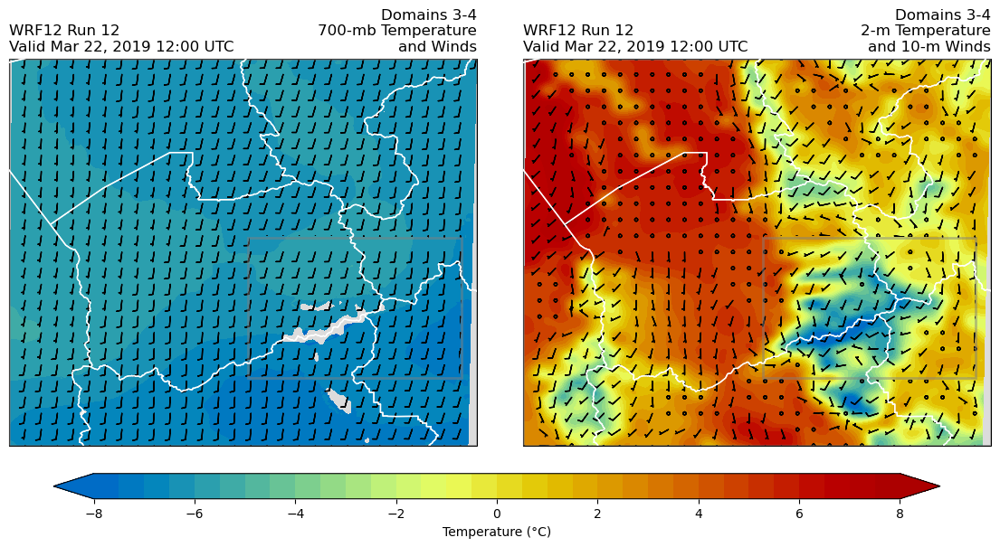

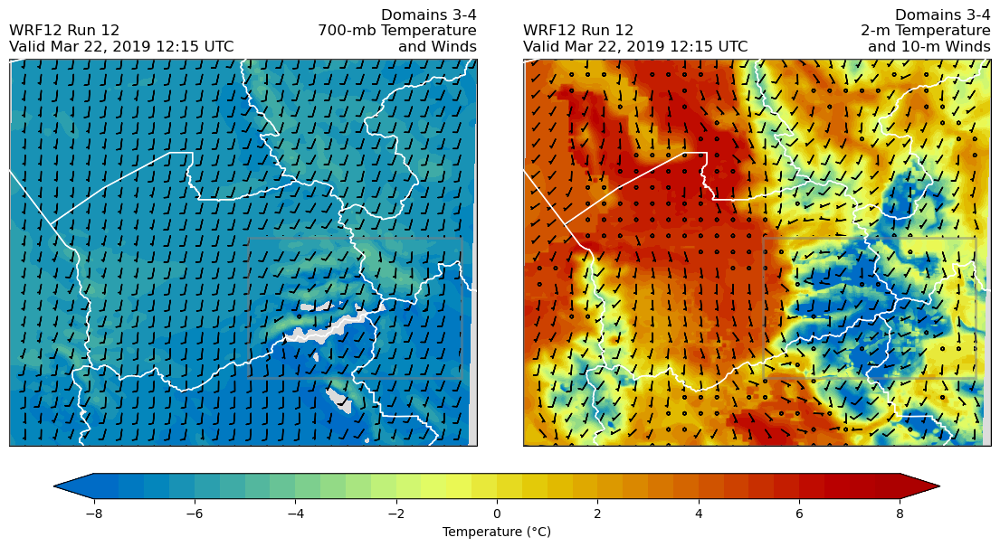

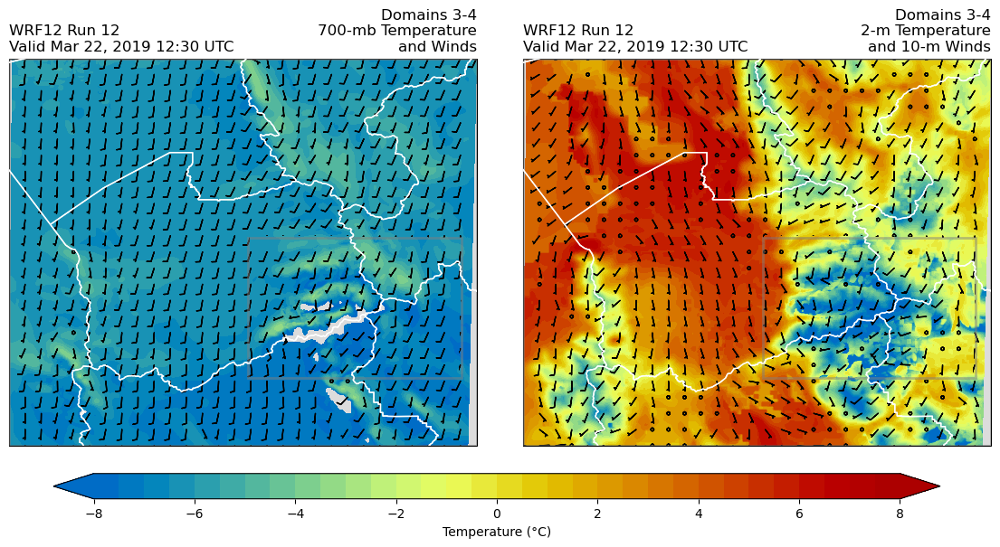

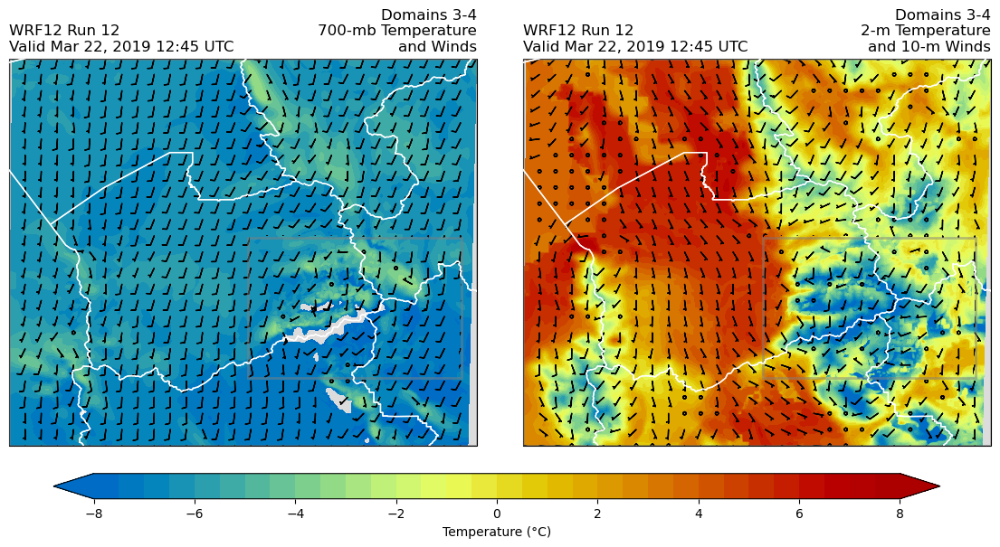

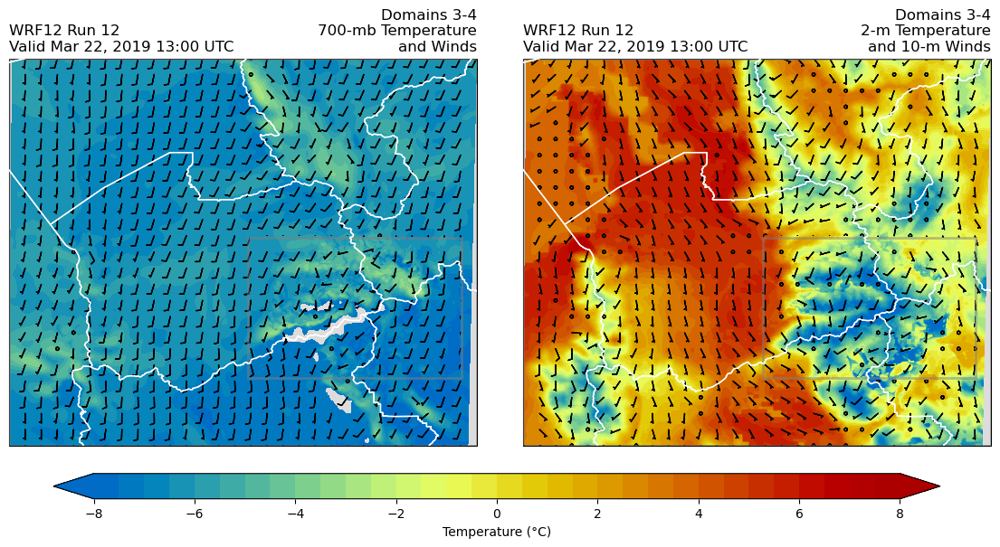

...

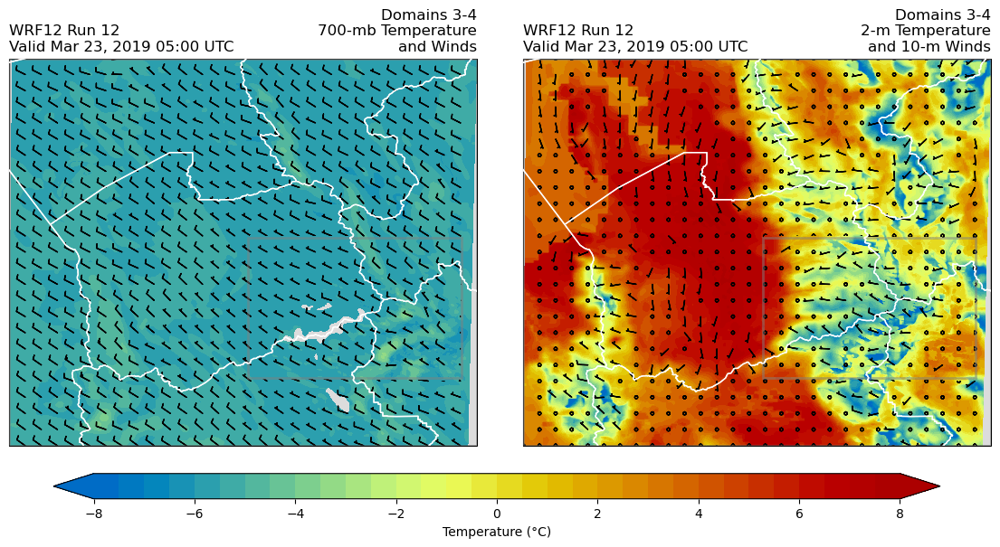

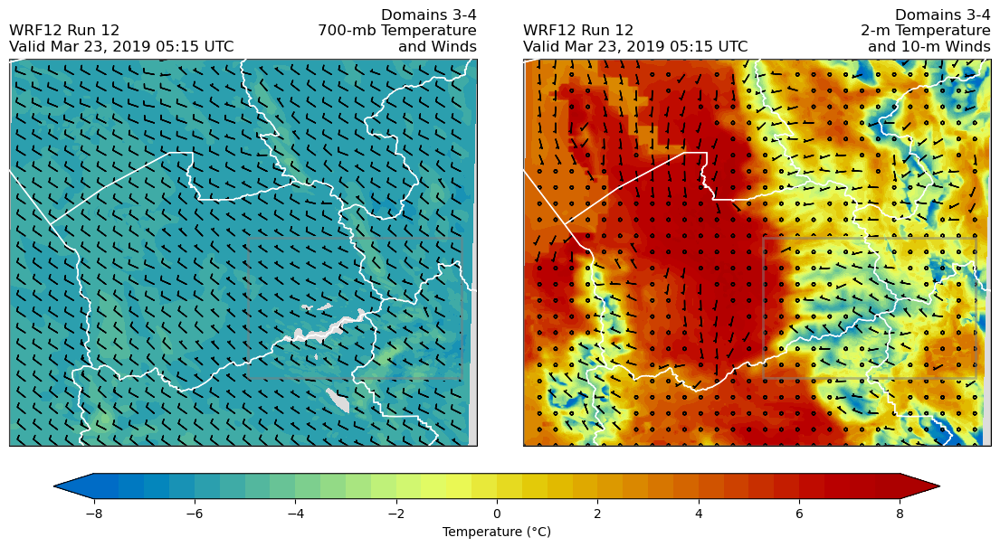

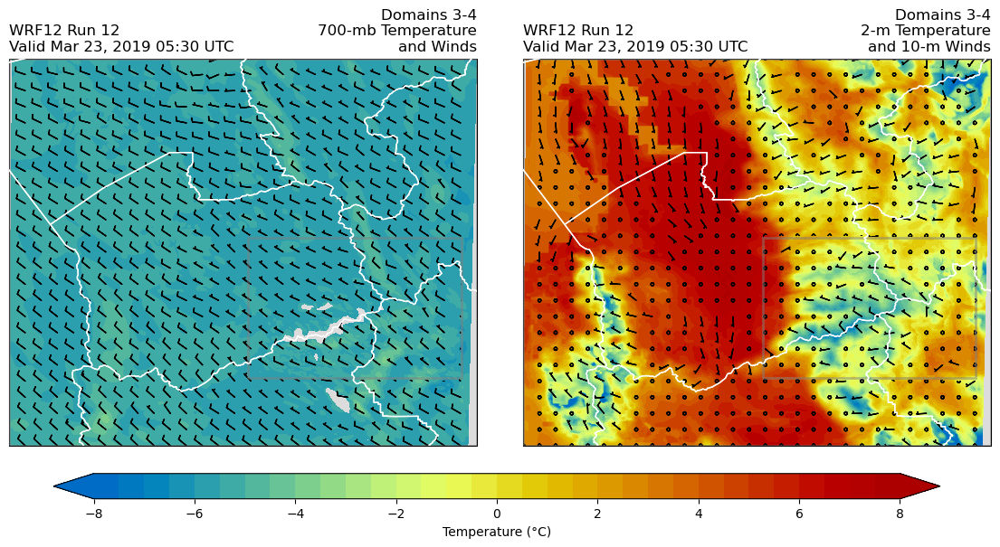

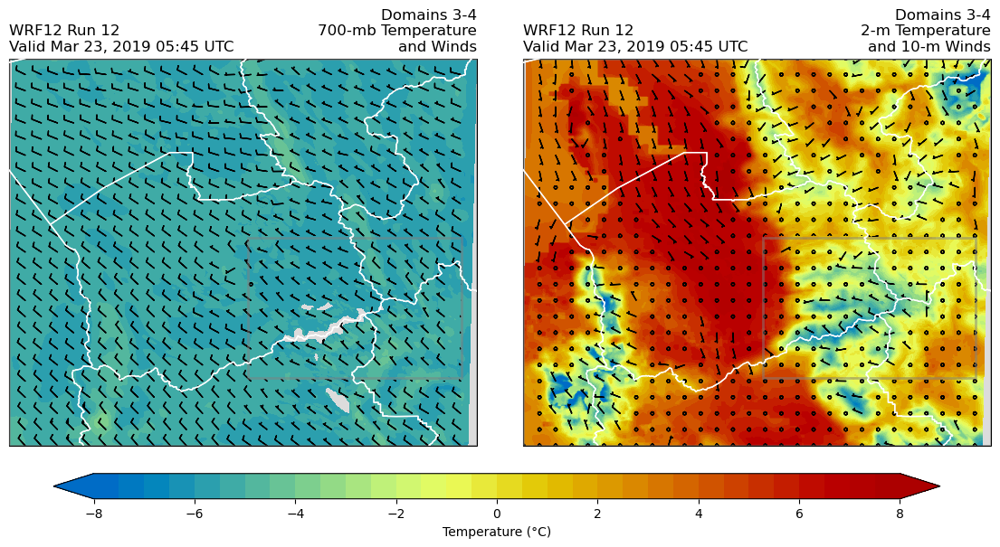

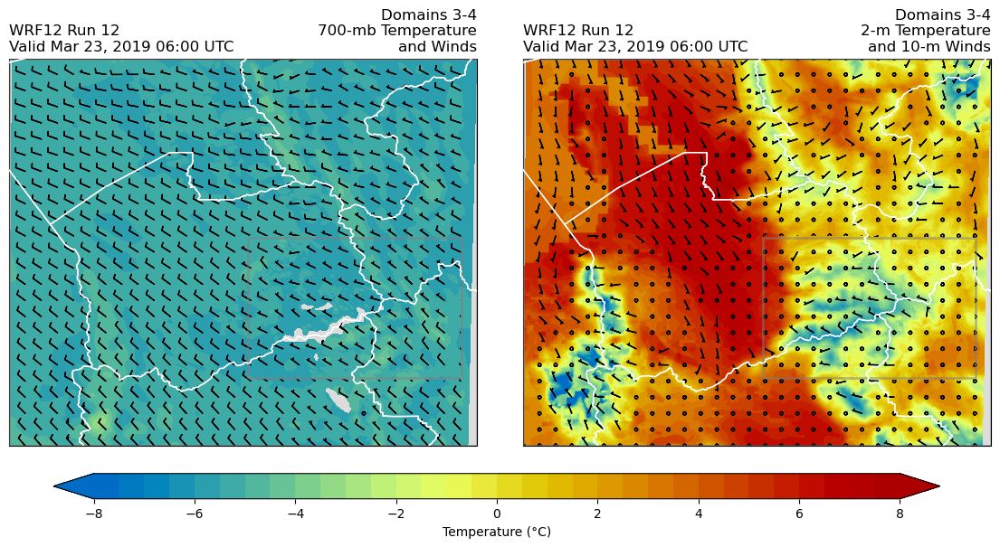

In [2]:
for i, time_of_interest in enumerate(time_of_interest_list[:]):
    time_of_interest_WRF = time_of_interest.strftime('%Y-%m-%d_%H:%M:%S')
    time_HRRR = time_of_interest.strftime('%Y-%m-%d %H:%M')
    time_of_interest_title = datetime.datetime.strftime(time_of_interest, '%b %-d, %Y %H:%M UTC')
    time_of_interest_save = datetime.datetime.strftime(time_of_interest, '%Y%m%d%H%M%S')
    time_of_intererst_prior = (time_of_interest - datetime.timedelta(hours = 1)).strftime('%Y-%m-%d_%H:%M:%S')


    # WRF data files
    ds_d03 = Dataset(data_files_d03[i])
    ds_d04 = Dataset(data_files_d04[i])

    ########### DOmain 3 ############
    ht_d03 = getvar(ds_d03, "z", timeidx=-1)
    ter_d03 = getvar(ds_d03, "ter", timeidx=-1)
    u_d03 =  getvar(ds_d03, "ua", timeidx = -1)
    v_d03 =  getvar(ds_d03, "va",  timeidx = -1)
    lati_d03, long_d03 = latlon_coords(ter_d03)
    p_d03 = getvar(ds_d03, 'pressure',  timeidx = -1)
    tc_d03 = getvar(ds_d03, 'tc',  timeidx = -1)
    T2_d03 = getvar(ds_d03, 'T2', timeidx = -1)
    uvmet10_d03 = getvar(ds_d03, 'uvmet10', timeidx = -1)

    # Stuff for boundaries
    geobounds = wrf.geo_bounds(wrfin=ds_d03)
    bottom_latitude_d03 = geobounds.bottom_left.lat
    left_longitude_d03 = geobounds.bottom_left.lon
    top_latitude_d03 = geobounds.top_right.lat
    right_longitude_d03 = geobounds.top_right.lon


    ########### DOmain 4 ############
    ht_d04 = getvar(ds_d04, "z", timeidx=-1)
    ter_d04 = getvar(ds_d04, "ter", timeidx=-1)
    u_d04 =  getvar(ds_d04, "ua", timeidx = -1)
    v_d04 =  getvar(ds_d04, "va",  timeidx = -1)
    lati_d04, long_d04 = latlon_coords(ter_d04)
    p_d04 = getvar(ds_d04, 'pressure',  timeidx = -1)
    tc_d04 = getvar(ds_d04, 'tc',  timeidx = -1)
    T2_d04 = getvar(ds_d04, 'T2', timeidx = -1)
    uvmet10_d04 = getvar(ds_d04, 'uvmet10', timeidx = -1)
    
    #Stuff for boundaries
    geobounds = wrf.geo_bounds(wrfin=ds_d04)
    bottom_latitude_d04 = geobounds.bottom_left.lat
    left_longitude_d04 = geobounds.bottom_left.lon
    top_latitude_d04 = geobounds.top_right.lat
    right_longitude_d04 = geobounds.top_right.lon



    #################### Interpolate to a level ###################
    level_to_interp = 700 # mbar

    ########### DOmain 3 ############   
    u_lev_d03 = wrf.interplevel(field3d=u_d03, vert=p_d03, desiredlev=level_to_interp,)
    v_lev_d03 = wrf.interplevel(field3d=v_d03, vert=p_d03, desiredlev=level_to_interp,)
    tc_lev_d03 = wrf.interplevel(field3d=tc_d03, vert=p_d03, desiredlev=level_to_interp,)
    
    u_sfc_d03 = uvmet10_d03.sel(u_v = 'u')
    v_sfc_d03 = uvmet10_d03.sel(u_v = 'v')
    tc_sfc_d03 = T2_d03 - 273.15

    ########### DOmain 4 ############   
    u_lev_d04 = wrf.interplevel(field3d=u_d04, vert=p_d04, desiredlev=level_to_interp,)
    v_lev_d04 = wrf.interplevel(field3d=v_d04, vert=p_d04, desiredlev=level_to_interp,)
    tc_lev_d04 = wrf.interplevel(field3d=tc_d04, vert=p_d04, desiredlev=level_to_interp,)
    
    u_sfc_d04 = uvmet10_d04.sel(u_v = 'u')
    v_sfc_d04 = uvmet10_d04.sel(u_v = 'v')
    tc_sfc_d04 = T2_d04 - 273.15
    
    fig, ((ax1, ax2)) = plt.subplots(1,2,figsize = (14, 14), facecolor = 'white', edgecolor = 'k',
                              subplot_kw = {'projection' : ccrs.PlateCarree()})


    ############################### ax1 WRF - 700 mbar ################################
    ######################### DOmain 3 ######################################
    ax1.set_extent([left_longitude_d03, right_longitude_d03, bottom_latitude_d03, top_latitude_d03], crs=ccrs.PlateCarree())
    T_Plot = ax1.contourf(long_d03, lati_d03, tc_lev_d03, transform = ccrs.PlateCarree(),levels = T_levels,
                colors = colors, extend = 'both', zorder=1)

    # Add the wind barbs, only plotting every 25th data point.
    skip = 1
    ax1.barbs(to_np(long_d03[::skip,::skip]), to_np(lati_d03[::skip,::skip]),
          to_np(u_lev_d03[::skip, ::skip]), to_np(v_lev_d03[::skip, ::skip]),
        length=4, zorder=3, color = 'black',regrid_shape = 25)

    # d03 box
    ax1.add_patch(matplotlib.patches.Rectangle((left_longitude_d03, bottom_latitude_d03), right_longitude_d03-left_longitude_d03, top_latitude_d03-bottom_latitude_d03,
             fill=None, lw=2, edgecolor='grey', zorder=50,transform = ccrs.PlateCarree(), alpha = 0.5))

    ######################## DOmain 4 ######################################

    ref_plot = ax1.contourf(long_d04, lati_d04, tc_lev_d04, transform = ccrs.PlateCarree(),levels = T_levels,
                colors = colors, extend = 'both', zorder = 9)


    # Add the wind barbs, only plotting every 25th data point.
    skip = 1
    ax1.barbs(to_np(long_d04[::skip,::skip]), to_np(lati_d04[::skip,::skip]),
          to_np(u_lev_d04[::skip, ::skip]), to_np(v_lev_d04[::skip, ::skip]),
        length=4,  color = 'black', zorder = 11, regrid_shape = 25)

    # d03 box
    ax1.add_patch(matplotlib.patches.Rectangle((left_longitude_d04, bottom_latitude_d04), right_longitude_d04-left_longitude_d04, top_latitude_d04-bottom_latitude_d04,
             fill=None, lw=2, edgecolor='grey', zorder=50,transform = ccrs.PlateCarree(), alpha = 0.5))


    #     # Add U.S. state borders
    ax1.add_feature(cfeature.STATES, edgecolor='white', linewidth=0.5, zorder = 10)
    ax1.add_feature(USCOUNTIES.with_scale('500k'), edgecolor = 'white', zorder = 51)

    ax1.set_title('Domains 3-4\n700-mb Temperature\nand Winds', loc = 'right')
    ax1.set_title('WRF{} Run {}\nValid {}'.format(path, run, time_of_interest_title), loc = 'left')

    ax1.set_facecolor('gainsboro')


    ############################### ax2 WRF - SURFACE ################################
    ######################### DOmain 3 ######################################
    ax2.set_extent([left_longitude_d03, right_longitude_d03, bottom_latitude_d03, top_latitude_d03], crs=ccrs.PlateCarree())
    T_Plot = ax2.contourf(long_d03, lati_d03, tc_sfc_d03, transform = ccrs.PlateCarree(),levels = T_levels,
                colors = colors, extend = 'both', zorder=1)

    # Add the wind barbs, only plotting every 25th data point.
    skip = 1
    ax2.barbs(to_np(long_d03[::skip,::skip]), to_np(lati_d03[::skip,::skip]),
          to_np(u_sfc_d03[::skip, ::skip]), to_np(v_sfc_d03[::skip, ::skip]),
        length=4, zorder=3, color = 'black',regrid_shape = 25)

    # d03 box
    ax2.add_patch(matplotlib.patches.Rectangle((left_longitude_d03, bottom_latitude_d03), right_longitude_d03-left_longitude_d03, top_latitude_d03-bottom_latitude_d03,
             fill=None, lw=2, edgecolor='grey', zorder=50,transform = ccrs.PlateCarree(), alpha = 0.5))

    ######################## DOmain 4 ######################################

    ref_plot = ax2.contourf(long_d04, lati_d04, tc_sfc_d04, transform = ccrs.PlateCarree(),levels = T_levels,
                colors = colors, extend = 'both', zorder = 9)


    # Add the wind barbs, only plotting every 25th data point.
    skip = 1
    ax2.barbs(to_np(long_d04[::skip,::skip]), to_np(lati_d04[::skip,::skip]),
          to_np(u_sfc_d04[::skip, ::skip]), to_np(v_sfc_d04[::skip, ::skip]),
        length=4,  color = 'black', zorder = 11, regrid_shape = 25)

    # d03 box
    ax2.add_patch(matplotlib.patches.Rectangle((left_longitude_d04, bottom_latitude_d04), right_longitude_d04-left_longitude_d04, top_latitude_d04-bottom_latitude_d04,
             fill=None, lw=2, edgecolor='grey', zorder=50,transform = ccrs.PlateCarree(), alpha = 0.5))


    # Add U.S. state borders
    ax2.add_feature(cfeature.STATES, edgecolor='white', linewidth=0.5, zorder = 10)
    ax2.add_feature(USCOUNTIES.with_scale('500k'), edgecolor = 'white', zorder = 51)

    ax2.set_title('Domains 3-4\n2-m Temperature\nand 10-m Winds', loc = 'right')
    ax2.set_title('WRF{} Run {}\nValid {}'.format(path, run, time_of_interest_title), loc = 'left')

    ax2.set_facecolor('gainsboro')


    # Add the color bar
    cax = plt.axes([0.16,0.30, 0.7, 0.02])
    cb_wa = fig.colorbar(ref_plot, cax = cax, orientation = 'horizontal', label = 'Temperature (°C)', fraction = 0.05,
                 ticks = T_levels[::4])
    cb_wa.ax.tick_params(labelsize=10)

    plt.subplots_adjust(wspace = 0.1)

    plt.savefig(Fig_dir + '2_D_{}.png'.format(time_of_interest_save), dpi = 300, bbox_inches = 'tight')
    plt.show()